<a href="https://colab.research.google.com/github/gdtschuller/Planets/blob/master/coronaconcucrrentlysick.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <center> Climate Change Calculated, Corona Update 2, 3
## <center>  or
# <center> The Power of Modelling and Estimations 

Prof. Dr.-Ing. G. Schuller

Ilmenau University of Technology

Institute for Media Technology

July, 2020


## Parent Website:
https://github.com/TUIlmenauAMS/CoronaComputationPrograms

# Connection to Climate Change:
* Climate change causes shifts in habitats of animals and plants,
* This leads to new contacts and encounters between animals and humans,
* This leads to increased opportunities fo viruses to jump between species,
* This is the origin of new and dangerous viruses and pandemics. 

## Goals:
* Plannability and certainty through modeling and data anlysis, 
* saftey through seeing the effectiveness of measures. 

## Highlights of this Presentation:
* Compares different countries internationally.
* Time plots show trends and developments over time, for predictions. 
* Uses models as comparison and for predictions
* Database is the Johns-Hopkins University online GitHub repository, for the most up-to-date data,

https://github.com/CSSEGISandData/COVID-19/tree/master/csse_covid_19_data/csse_covid_19_time_series

Accuracy: As with every measurement, there is only a limited accuracy of the data, in this case mostly by delayed notifcations. Comparing the Johns-Hopkins University Data with data from the Robert-Koch Institut shows an accuracy of about 1%. This is much better than we need for our purposes.
 
## Comparison of infection risk in different countries

Only people who are infected but did not yet recover or die are infectious. These are the concurrently or active sick.
The number of concurrently sick is the number of infected minus the number of recovered and deaths,
$$\rm{concurrently \, sick}= \rm{infected}- \rm{recovered} - \rm{deaths}$$

 First we choose the desired countries.


With the pulldown menues below you can select the coutries to compute and display, or select "Empty" for no country. There you can also select a start date for the computations, although you can also limit the display using the zoom tools in the plots. After selecting, click "Runtime - run all", or Ctl-F9:

In [1]:
#@title Countries selection: {run: "auto" }

#countries=["Italy", "Germany"]
countries=[]
#for i in range(2):
countrylist= ['Italy','Germany','Spain','Brazil', 'US', 'Russia','Korea, South', 'Austria', 'Lebanon', 'India','France', 'Ireland']

country0 = "Italy" #@param ['Italy','Spain', 'Brazil', 'US', 'Russia','Korea, South', 'Austria', 'Lebanon', 'India','France','Switzerland','Sweden', 'United Kingdom', 'Ireland']
countries.append(country0)

country1 = "Germany" #@param ['Germany']
countries.append(country1)

country2 = "Spain" #@param ['Italy','Spain', 'Brazil', 'US', 'Russia','Korea, South', 'Austria', 'Lebanon', 'India','France','Switzerland','Sweden', 'United Kingdom', 'Ireland', 'Portugal', 'Empty']
if country2 != "Empty":
  countries.append(country2)

country3 = "France" #@param ['Italy','Spain', 'Brazil', 'US', 'Russia','Korea, South', 'Austria', 'Lebanon', 'India','France','Switzerland','Sweden', 'United Kingdom', 'Ireland', 'Portugal', 'Empty']
if country3 != "Empty":
  countries.append(country3)

country4 = "US" #@param ['Italy','Spain', 'Brazil', 'US', 'Russia','Korea, South', 'Austria', 'Lebanon', 'India','France','Switzerland','Sweden', 'United Kingdom', 'Ireland', 'Portugal','Empty']
if country4 != "Empty":
  countries.append(country4)

country5 = "Portugal" #@param ['Italy','Spain', 'Brazil', 'US', 'Russia','Korea, South', 'Austria', 'Lebanon', 'India','France','Switzerland','Sweden', 'United Kingdom', 'Ireland', 'Portugal','Empty']
if country5 != "Empty":
  countries.append(country5)

country6 = "Korea, South" #@param ['Italy','Spain', 'Brazil', 'US', 'Russia','Korea, South', 'Austria', 'Lebanon', 'India','France','Switzerland','Sweden', 'United Kingdom', 'Ireland', 'Portugal','Empty']
if country6 != "Empty":
  countries.append(country6)

#remove duplicates:
countries = list(dict.fromkeys(countries))
print("countries=",countries)

popul={'Italy': 60.36, 'Germany': 83.02, 'Spain':46.94, 'Brazil':209.5, 'US':328.2, 'Russia':144.5,'Korea, South': 51.64, 'Austria': 8.859, 'Lebanon':6.849, 'India':1353,'France':67, 'United Kingdom': 66.7, 'Switzerland':8.5, 'Sweden': 10.23, 'Ireland': 4.9, 'Portugal': 10.28}
population=[]
for co in countries:
  population.append(popul[co])

print("populations=", population)

#@title Date fields
startdate = '2020-03-01' #@param {type:"date"}

#print("startdate=", startdate)

from datetime import datetime
date=datetime.strptime(startdate,'%Y-%m-%d')
startdate=date.strftime('%-m/%-d/%y')
print("startdate=", startdate)


countries= ['Italy', 'Germany', 'Spain', 'France', 'US', 'Portugal', 'Korea, South']
populations= [60.36, 83.02, 46.94, 67, 328.2, 10.28, 51.64]
startdate= 3/1/20


In [2]:
#@title Concurrently Sick Internationally {display-mode: "form"}
#Number of concurrently sick from data from JHU github
#Computes the difference of detected infected minus recovered minus deaths
#Gerald Schuller, May 2020

#countries = ['Italy', 'Germany', 'Spain', 'Brazil', 'US', 'Russia','Korea, South', 'Austria', 'Lebanon', 'India','France']
#population=[60.36, 83.02, 46.94, 209.5, 328.2, 144.5, 51.64, 8.859, 6.849, 1353, 67]
#countries = ['Germany', 'US']
#population=[60.36, 328.2]

#countries = ['Italy', 'Germany', 'Spain', 'Brazil', 'Switzerland', 'Russia','Korea, South', 'Austria', 'Lebanon', 'India','France']
#population=[60.36, 83.02, 46.94, 209.5, 8.5, 144.5, 51.64, 8.859, 6.849, 1353, 67]
#startdate='3/1/20'

#print("countries=", countries)
#print("population (in Million)=", population)

import numpy as np
import matplotlib
#matplotlib.use('nbagg')
import matplotlib.pyplot as plt

#Read data from github:
import urllib.request
import pandas as pd

Retrievedata=True

#Cases
if Retrievedata:
   url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv'
   urllib.request.urlretrieve(url, './corona_cases.csv')
#('./corona_cases.csv', <http.client.HTTPMessage object at 0x7fc7d89c0f98>)
   url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_recovered_global.csv'
   urllib.request.urlretrieve(url, './corona_recovered.csv')
   url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv'
   urllib.request.urlretrieve(url, './corona_deaths.csv')

#detected cases:
df = pd.read_csv('./corona_cases.csv')
df=df.loc[df['Province/State'].isnull()] #remove overseas territories, e.g. for UK
#df.head()
df=df.drop(['Lat','Long','Province/State'], axis=1)
df=df.set_index('Country/Region')
datacases=df.loc[countries,: ]

#recovered cases:
df = pd.read_csv('./corona_recovered.csv')
df=df.loc[df['Province/State'].isnull()] #remove overseas territories, e.g. for UK
#df.head()
df=df.drop(['Lat','Long','Province/State'], axis=1)
df=df.set_index('Country/Region')
datarecovered=df.loc[countries,: ]

#death cases:
df = pd.read_csv('./corona_deaths.csv')
df=df.loc[df['Province/State'].isnull()] #remove overseas territories, e.g. for UK
#df.head()
df=df.drop(['Lat','Long','Province/State'], axis=1)
df=df.set_index('Country/Region')
datadeaths=df.loc[countries,: ]

dates=datacases.loc[countries[0],startdate:].index
#print("dates=\n",dates)

countrycases=datacases.loc[countries,startdate:].reset_index(drop=True)
countrycases=np.array(countrycases)
countryrecovered=datarecovered.loc[countries,startdate:].reset_index(drop=True)
countryrecovered=np.array(countryrecovered)
countrydeaths=datadeaths.loc[countries,startdate:].reset_index(drop=True)
countrydeaths=np.array(countrydeaths)
concurrentlysick=countrycases-countryrecovered-countrydeaths 

#For estimates for missing data use the 14 day incidence:
incidencedays=14 #rounded 11.5 days, from Corona Update
incidence=countrycases[:,incidencedays:]-countrycases[:,:-incidencedays] #Total infected - total infected 19 days ago
concurrentlysickest=np.hstack((np.zeros((len(countries),incidencedays)),incidence)) #estimate of the concurrently sick as 19-day incidence
recovereddeathest=np.hstack((np.zeros((len(countries),incidencedays)),countrycases[:,:-incidencedays])) #estimate for the recovered plus deaths

# For Google Colab Only
inColab=False
try:
    import google.colab
    import plotly.io as pio
    pio.renderers.default = 'colab'
    def enable_plotly_in_cell():
        import IPython
        from plotly.offline import init_notebook_mode
        display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
        init_notebook_mode(connected=False)
    inColab=True
    
except Exception as e:
    print("Not inside Google Colab: %s. Using standard configurations." % (e))
 
# Imports
!pip install chart_studio > Null
import chart_studio
import numpy as np
import matplotlib.pyplot as plt
import plotly.offline
import plotly.tools as tls
#import plotly.plotly as py
import chart_studio.plotly as py
 
# Configurations
plotly.offline.init_notebook_mode(connected=True)
import warnings; warnings.simplefilter('ignore')
config = {'displayModeBar': True,'scrollZoom': False}
 
#plot
if inColab:
    enable_plotly_in_cell()

from matplotlib.dates import (datestr2num, num2date)
%pylab inline
pylab.rcParams['figure.figsize'] = (10, 10)
datesplot=datestr2num(dates)
#print("datesplot=", datesplot)

fig, ax = plt.subplots(1,1) 
for cnum in range(len(countries)):
   #f.line(datestype.values, tcspm[:,cnum] , legend_label=countries[cnum], line_width=2, name=countries[cnum],color=mpl11[cnum])
   if concurrentlysickest[cnum,-1] < 0.2* concurrentlysick[cnum,-1]:
       print("Plot 14 day incidence as estimate for concurrently sick for "+countries[cnum]) 
       concurrentlysick[cnum,:]=concurrentlysickest[cnum,:] #replace by estimate
   plt.plot_date(datesplot, concurrentlysick[cnum,:], linestyle='solid', marker='None',label=countries[cnum])

plt.xticks(rotation=45)
#plt.legend(countries)
plt.xlabel('Day since '+startdate)
plt.ylabel('Concurrently Sick')
plt.grid()
plt.title('Plot 1: Concurrently sick internationally')

plotly_fig = tls.mpl_to_plotly(fig)
plotly_fig.layout.update(showlegend=True)
plotly.offline.iplot(plotly_fig,config=config)


Populating the interactive namespace from numpy and matplotlib
Plot 14 day incidence as estimate for concurrently sick for Spain
Plot 14 day incidence as estimate for concurrently sick for France
Plot 14 day incidence as estimate for concurrently sick for US


In [3]:
#@title Concurrently Sick Germany, Comparison with my Model from March  {display-mode: "form"}
#@markdown This model (blue curve) shows my best case scenario, which I called "A Possible Solution". 
#@markdown You can see that Germany stayed more or less close to it. This model can be seen as a "target" to reach.

from matplotlib.dates import (datestr2num, num2date, date2num)
import datetime

factorincrease=1.02  #increase factor day to day
valueondate=639  #value on a given day
dayofvalue=6 #the given day of the month of the value
K=83e6 #Population of Germany
timetorecovery=16 #days from dicovering to recovery

#print(datetime.date(2020, 3, 1))
startdatenum = datestr2num(startdate) #date2num(datetime.date(2020, 3, 1))
#print("Startdatenum=", startdatenum)

#Logistic function for the prediction: 
def logistic(K, valueondate, factorincrease, t):
   #logistic function for exponential growth with saturation at population size K
   #starting from a value on a given date "valueondate"
   #factor for the increase from day to day is "factorincrease"
   #prediction for the number of days "t" after the given day,
   #prediction before the given date is obtained by using negative values for t
   return K/(1+ ((K-valueondate)/valueondate)*np.exp(-np.log(factorincrease)*t ))

#Plot range in days:
t=np.arange(1,400) #prediction for this range of days of the month. For the next month, use day numbers larger that 30.
datefc=startdatenum+t

#plot
if inColab:
    enable_plotly_in_cell()

mymodel=logistic(K, valueondate, factorincrease, t-dayofvalue) -logistic(K, valueondate, factorincrease, t-timetorecovery-dayofvalue)
fig, ax = plt.subplots(1,1) 
plt.plot_date(datefc, mymodel, linestyle='solid', marker='None',label= 'Logistic Model from March' )
plt.plot_date(datesplot, concurrentlysick[1,:], linestyle='solid', marker='None',label=countries[1])
#ax.xaxis.set_tick_params(rotation=30, labelsize=10)
plt.xlabel('Date')
plt.ylabel('Current Corona Cases')
plt.grid()
plt.title('Plot 2: Currently Sick Cases in Germany, comparison with my logistic model with increase factor of 1.02')
#plt.show()
plotly_fig = tls.mpl_to_plotly(fig)
plotly_fig.layout.update(showlegend=True)
plotly.offline.iplot(plotly_fig)

In [4]:
#@title Sonification of the Data {display-mode: "form"}
#@markdown We can represent the two above curves as two tones, whose amplitude is proportional to the values of the curves over time.
#@markdown My model is represented as the lower pitch tone, the measured data as the higher pitch tone.
#@markdown Click the play button below to hear the resulting sound.
from IPython.display import Audio
import scipy.io.wavfile as wav
def ampmod(omega, sig):
  #function for frequency modulation of a sinusoid from signal sig
  sigup=np.repeat(sig, 120)+0.0
  t=np.arange(len(sigup))
  tone=0.5*(1/np.max(sig)*sigup)*np.sin(omega*t)
  return tone

tone1=ampmod(0.1,mymodel)
tone2=ampmod(0.2,concurrentlysick[1,:])
lendiff=len(tone1)-len(tone2)
tone2=np.append(tone2,zeros(lendiff))

wav.write("tone.wav",32000,np.int16((tone1+tone2)*2**14))
Audio("tone.wav")

## Concurrently Sick per Million Inhabitants

We can now compare the "infectiousness" of different countries by comparing their density of concurrently sick (per Million inhabitants).
Since countries have very different populations, it makes sense to calculate the concurrently sick per million inhabitants.
It is obtained by dividing the number of concurrently sick by the number of inhabitants in millions.
This is also what is needed to estimate the risk of infection. To get a more accurate estimate, it should be multiplied by the rough under detection rate, see below (not included here for simplicity).

In [5]:
#@title Concurrently Sick per Million inhabitants {display-mode: "form"}
# For Google Colab Only
inColab=False
try:
    import google.colab
    import plotly.io as pio
    pio.renderers.default = 'colab'
    def enable_plotly_in_cell():
        import IPython
        from plotly.offline import init_notebook_mode
        display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
        init_notebook_mode(connected=False)
    inColab=True
    
except Exception as e:
    print("Not inside Google Colab: %s. Using standard configurations." % (e))
 
# Imports
!pip install chart_studio > Null
import chart_studio
import numpy as np
import matplotlib.pyplot as plt
import plotly.offline
import plotly.tools as tls
#import plotly.plotly as py
import chart_studio.plotly as py
 
# Configurations
plotly.offline.init_notebook_mode(connected=True)
import warnings; warnings.simplefilter('ignore')
 
#plot
if inColab:
    enable_plotly_in_cell()

from matplotlib.dates import (datestr2num, num2date)

pylab.rcParams['figure.figsize'] = (10, 10)
datesplot=datestr2num(dates)
#print("datesplot=", datesplot)

fig, ax = plt.subplots(1,1) 
for cnum in range(len(countries)):
   #f.line(datestype.values, tcspm[:,cnum] , legend_label=countries[cnum], line_width=2, name=countries[cnum],color=mpl11[cnum])
   plt.plot_date(datesplot, concurrentlysick[cnum,:]/population[cnum], linestyle='solid', marker='None',label=countries[cnum])

plt.xticks(rotation=45)
#plt.legend(countries)
plt.xlabel('Day since '+startdate)
plt.ylabel('Concurrently Sick')
plt.grid()
plt.title('Plot 3: Concurrently sick per Million Inhabitants internationally')

plotly_fig = tls.mpl_to_plotly(fig)
plotly_fig.layout.update(showlegend=True)
plotly.offline.iplot(plotly_fig)

## The Effect of Social Distancing and Mask Wearing

Belows plot for March and April shows the effect of Germany's introduction of leaving home restrictions towards the end of March. In mid April the restriction was loosened and repleaced by mask wearing. A week after end of March (approximately the time from infection to detection), the curve indeed goes down noticeably. Observe: The curve continues to go down even after the leaving home restriction was replaced by mask wearing, so mask wearing indeed seems to be about as effective as staying home.

<Figure size 720x720 with 0 Axes>

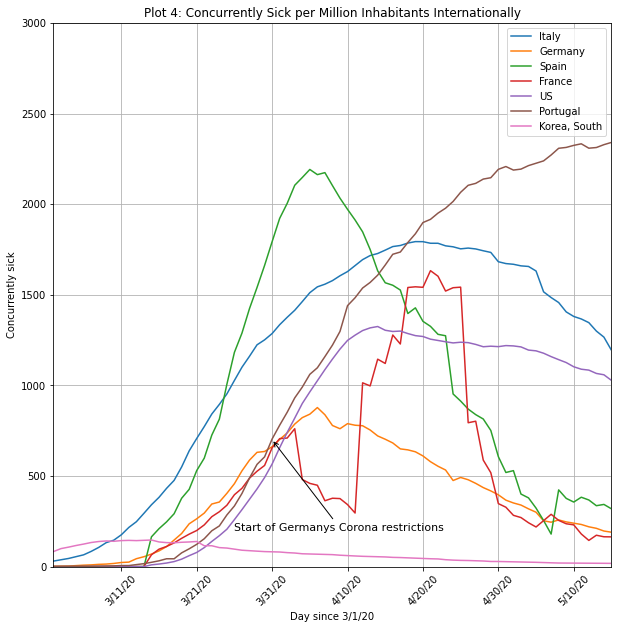

<Figure size 720x720 with 0 Axes>

In [6]:
#@title Concurrently Sick, Zoom to Germany in Spring {display-mode: "form"}
pylab.rcParams['figure.figsize'] = (10, 10)
fig, ax = plt.subplots(1,1) 
ax.plot(dates,concurrentlysick.T/population)
ax.set_xticks(np.arange(0,len(dates),10))
plt.xticks(rotation=45)
#plt.plot(concurrentlysick.T/population)
plt.legend(countries)
plt.xlabel('Day since '+startdate)
plt.ylabel('Concurrently sick')
plt.grid()
ann = plt.annotate('Start of Germanys Corona restrictions', fontsize=11,xy=(30,700),xytext=(25,200), arrowprops=dict(arrowstyle='->'))
plt.title('Plot 4: Concurrently Sick per Million Inhabitants Internationally')
plt.axis([1,75,0, 3000])
#plt.show()
plt.figure()

In [7]:
#@title 7-Day Incidence per 100 000 Inhabitants {display-mode: "form"}
#@markdown This is the sum of new infections over the preceding 7 days per 100 000 inhabitants.

#@markdown It is a rate of new infections, but only a rough approximation for the number of
#@markdown concurrently sick because the time from detection to recovery or death is closer 
#@markdown to 12-19 days for countries like Germany or South Korea, not 7 days. 

# Configurations
plotly.offline.init_notebook_mode(connected=True)
import warnings; warnings.simplefilter('ignore')
 
#plot
if inColab:
    enable_plotly_in_cell()

from matplotlib.dates import (datestr2num, num2date)

pylab.rcParams['figure.figsize'] = (10, 10)
datesplot=datestr2num(dates)
#print("datesplot=", datesplot)
sevendayinfected=countrycases[:,7:]-countrycases[:,:-7] #Total infected - total infected 7 days ago
datesplt=datestr2num(dates[7:])
fig, ax = plt.subplots(1,1) 
for cnum in range(len(countries)):
   #f.line(datestype.values, tcspm[:,cnum] , legend_label=countries[cnum], line_width=2, name=countries[cnum],color=mpl11[cnum])
   plt.plot_date(datesplt, sevendayinfected[cnum,:]/(10*population[cnum]), linestyle='solid', marker='None',label=countries[cnum])

plt.xticks(rotation=45)
#plt.legend(countries)
plt.xlabel('Day since '+startdate)
plt.ylabel('7-Day Incidence')
plt.grid()
plt.title('Plot 5: 7-Day Incidence per 100 000 Inhabitants internationally')

plotly_fig = tls.mpl_to_plotly(fig)
plotly_fig.layout.update(showlegend=True)
plotly.offline.iplot(plotly_fig)

## Computation of the Underdetection Rate

The underdetection rate takes into account how much testing is done, including its accuracy. It is an estimate of how many more true infected there are compared to the detected infected. It is computed as the ratio of the case fatality rate to the infection based fatality rate,
$$\rm{Underdetection\, rate}={\rm{case \, fatality \, rate}\over{\rm{infection \, fatality \, rate}}}$$ 

The estimation of the infection based fatality rate varies (usually 0.6% to 5%), and is assumed to be 2% here (see my Corona Update Video). This can also differ somewhat between countries, depending on the average age of the population and the health system, so the 2% is a more or less rough estimate. Keep in mind that it can also be about a factor 2 larger or smaller. 

The case fatality rate is computed as, 

$$\rm{case\, fatality\, rate}={\rm{deaths}\over{\rm{deaths}+ \rm{recovered}}}$$ 

here using the accumulated data to obtain more stable results. This works only for countries who report the number of recovered (not e.g. Sweden).
Observe how testing became clearly better of time, reducing the underdetection rate.

In [8]:
#@title Underdetection Rate {display-mode: "form"}
casefatalityrate=countrydeaths/(countryrecovered+countrydeaths) #case fatality rate
casefatalityrateest=countrydeaths/(recovereddeathest) #case fatality rate estimate

underdetectionrate=casefatalityrate/0.02 #underdetection rate = case fatality rate / infection fatality rate( 0.02)
underdetectionrateest= casefatalityrateest/0.02 #estimation

pylab.rcParams['figure.figsize'] = (10, 10)
# Configurations
plotly.offline.init_notebook_mode(connected=True)
import warnings; warnings.simplefilter('ignore')
 
#plot
if inColab:
    enable_plotly_in_cell()

fig, ax = plt.subplots(1,1) 
#datesplot=datestr2num(dates)
for cnum in range(len(countries)):
   #f.line(datestype.values, tcspm[:,cnum] , legend_label=countries[cnum], line_width=2, name=countries[cnum],color=mpl11[cnum])
   if countryrecovered[cnum,-1]+ countrydeaths[cnum,-1] < 0.2* recovereddeathest[cnum,-1] :
       print("Using 14 day incidence for estimating underdetection rate for "+countries[cnum]) 
       underdetectionrate[cnum,:]=underdetectionrateest[cnum,:] #replace by estimate
   plt.plot_date(datesplot, underdetectionrate[cnum,:], linestyle='solid', marker='None',label=countries[cnum])

plt.xlabel('Day since '+startdate)
plt.ylabel('Underdetection Rate')
plt.ylim(0,50)
plt.grid()
plt.title('Plot 6: Underdetection Rate of Different Countries')

plotly_fig = tls.mpl_to_plotly(fig)
plotly_fig.layout.update(showlegend=True)
plotly.offline.iplot(plotly_fig)

Using 14 day incidence for estimating underdetection rate for Spain
Using 14 day incidence for estimating underdetection rate for France
Using 14 day incidence for estimating underdetection rate for US


## Estimated True Concurrently Sick
We can multiply our number of the concurrently sick (detection based) by the underdetection rate above to obtain an estimate of the true concurrently sick (infection based). 

The following plot is more interactive. After running it (with 'Runtime-Run all') you can use a zoom tool (activated with bringing the mouse to the right side of the plot), panning with the cross symbol, and reset.

In [9]:
#@title Estimated True Concurrently sick per Million inhabitants {display-mode: "form"}
"""
#Only first time necessary:
# For Google Colab Only
inColab=False
try:
    import google.colab
    import plotly.io as pio
    pio.renderers.default = 'colab'
    def enable_plotly_in_cell():
        import IPython
        from plotly.offline import init_notebook_mode
        display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
        init_notebook_mode(connected=False)
    inColab=True
    
except Exception as e:
    print("Not inside Google Colab: %s. Using standard configurations." % (e))
 
# Imports
!pip install chart_studio > Null
import chart_studio
import numpy as np
import matplotlib.pyplot as plt
import plotly.offline
import plotly.tools as tls
#import plotly.plotly as py
import chart_studio.plotly as py
""" 
# Configurations
plotly.offline.init_notebook_mode(connected=True)
import warnings; warnings.simplefilter('ignore')
 
#plot
if inColab:
    enable_plotly_in_cell()
 
#fig = plt.figure(figsize=(12,8))
fig, ax = plt.subplots(1,1) 
trueconcurrentlysick=underdetectionrate*concurrentlysick
datesplt=datestr2num(dates)
#print("datesplt=", datesplt)
for cnum in range(len(countries)):
   plt.plot_date(datesplt, trueconcurrentlysick[cnum,:]/population[cnum], linestyle='solid', marker='None',label=countries[cnum])
plt.xticks(rotation=45)
plt.xlabel('Day since '+startdate)
plt.ylabel('True Concurrently Sick')
plt.grid()
plt.title('Plot 7: Estimated True Concurrently sick per Million Inhabitants Internationally')
plt.ylim(0,80000)
 
plotly_fig = tls.mpl_to_plotly(fig)
plotly_fig.layout.update(showlegend=True)
plotly.offline.iplot(plotly_fig)

Observe that in this above plot the US has higher numbers earlier on because of their higher underdetection rates earlier, and was surpassed by Spain and France in the end of August.

## Resulting death cases per million inhabitants
The following plot shows the accumulated Corona deaths.

In [10]:
#@title Accumulated Death Cases per Million Inhabitants {display-mode: "form"}
#plot
if inColab:
    enable_plotly_in_cell()
 
#fig = plt.figure(figsize=(12,8))
fig, ax = plt.subplots(1,1) 
#trueconcurrentlysick=underdetectionrate*concurrentlysick
datesplt=datestr2num(dates)
#print("datesplt=", datesplt)
for cnum in range(len(countries)):
   plt.plot_date(datesplt, countrydeaths[cnum,:]/population[cnum], linestyle='solid', marker='None',label=countries[cnum])
plt.xticks(rotation=45)
plt.xlabel('Day since '+startdate)
plt.ylabel('Death cases per Million')
plt.grid()
plt.title('Plot 8: Death Cases per Million Inhabitants Internationally')
 
plotly_fig = tls.mpl_to_plotly(fig)
plotly_fig.layout.update(showlegend=True)
plotly.offline.iplot(plotly_fig)

The above values are the **confirmed** COVID-19 deaths.

**Comparison to Influenza:**

**Excess mortality** of a heavy influenza season: ca. 200 deaths per Million inhabitants. These also **include other causes** of death.
(https://www.cdc.gov/flu/about/burden/index.html)

**Confirmed** influenza death of a heavy influenza season: ca. **20** deaths per Million inhabitants. These are only the **confirmed** influenza deaths. (https://www.pharmazeutische-zeitung.de/vorsicht-bei-vergleich-der-zahl-der-todesfaelle-116540/)

This is the **more suitable comparison** to the above COVID-19 deaths.

Observe that Germany and the US already **surpassed** these 20 deaths per Million inhabitants in **early April**!

In [11]:
#@title Accumulated Death Cases Germany, Comparison with my Model from March  {display-mode: "form"}
#@markdown This model shows my best case scenarion, which I called "A Possible Solution". 
#@markdown You can see that Germany stayed more or less close to it.
from matplotlib.dates import (datestr2num, num2date, date2num)
import datetime

factorincrease=1.02  #increase factor day to day
valueondate=639  #value on a given day
dayofvalue=6 #the given day of the month of the value
K=83e6 #Population of Germany
timetorecovery=16 #days from dicovering to recovery

#print(datetime.date(2020, 3, 1))
startdatenum = datestr2num(startdate) #date2num(datetime.date(2020, 3, 1))
print("Startdate=", startdate)

#Plot range in days:
t=np.arange(1,400) #prediction for this range of days of the month. For the next month, use day numbers larger that 30.
datefc=startdatenum+t

#plot
if inColab:
    enable_plotly_in_cell()

cnum=1 #Germany
fig, ax = plt.subplots(1,1) 
plt.plot_date(datefc, logistic(K, valueondate, factorincrease, t-timetorecovery-dayofvalue)*0.07/population[cnum], linestyle='solid', marker='None',label= 'Logistic Model from March' )
#0.07 detection based, 0.02 infection based
plt.plot_date(datesplot, countrydeaths[cnum,:]/population[cnum], linestyle='solid', marker='None',label=countries[1])
#ax.xaxis.set_tick_params(rotation=30, labelsize=10)
plt.xlabel('Day after beginning of March')
plt.ylabel('Cumulative Death Cases')
plt.grid()
plt.title('Plot 9: Accumulated Death Cases per Million Inhabitants in Germany, comparison with my logistic model with increase factor of 1.02')
#plt.show()
plotly_fig = tls.mpl_to_plotly(fig)
plotly_fig.layout.update(showlegend=True)
plotly.offline.iplot(plotly_fig)

Startdate= 3/1/20


## Increase factor of the concurrently sick

For analysis, we can calculate the increase factor of the concurrently sick as a quotient of the numbers for two consecutive days.
This quotient is the same for the absolute numbers or for the number of concurrently sick per million inhabitants.
It is related to the reproductive factor but not the same.

- Values greater than 1: Increase,

- less than 1: decrease,

- a constant value above 1: Exponential growth, similar to a fire that spreads.

This increase factor is almost the same for the true concurrently sick, since the underdetection rate only changes relatively slowly. Because this varies weekly because of the weekends, the following plot shows 7-day averages. 

In [12]:
#@title Factor of Increase of Concurrently Sick {display-mode: "form"}
plotly.offline.init_notebook_mode(connected=True)
import warnings; warnings.simplefilter('ignore')
 
#plot
if inColab:
    enable_plotly_in_cell()

pylab.rcParams['figure.figsize'] = (10, 10)
from scipy.ndimage import convolve1d
currsickfactorsofincrease=concurrentlysick[:,1:]/(concurrentlysick[:,:-1]) #factor of increase f for each country
smoothcurrsickfactorsofincrease= convolve1d(currsickfactorsofincrease, np.ones(7)/7, axis=1)
fig, ax = plt.subplots(1,1) 
#ax.plot(dates[1:],smoothcurrsickfactorsofincrease.T)
datesplt=datestr2num(dates[1:])
for cnum in range(len(countries)):
   plt.plot_date(datesplt, smoothcurrsickfactorsofincrease[cnum,:], linestyle='solid', marker='None',label=countries[cnum])
#ax.set_xticks(np.arange(0,len(dates[1:]),10))
plt.xticks(rotation=45)
#plt.plot(currsickfactorsofincrease.T)
#plt.legend(countries)
plt.xlabel('Day since '+startdate)
plt.ylabel('Factor of increase')
plt.grid()
plt.title('7-day Average Factor of Increase of Concurrently Sick')
plt.axis([datesplt[-1]-60, datesplt[-1],0.9, 1.2])
#ax.set_ylim(bottom=0.5, top=1.3)
#plt.show()
plotly_fig = tls.mpl_to_plotly(fig)
plotly_fig.layout.update(showlegend=True)
plotly.offline.iplot(plotly_fig)

Observe: In my video from March, Corona Special, I found we need an increase **factor of 1.02** to make it **sustainable until spring of 2021**. We indeed reached precisely this factor in Germany most of the year 2020! But in late September it started to increase again!

Next: A **prediction or forecast** of the concurrently sick for the next 60 days, based on its average increase factor for the last 7 days. It uses the logistic model from my "Special to Corona" video.

Set the number of days for the prediction:

In [13]:
predictiondays=60

In [14]:
#@title Forecast of Concurrently Sick per Million Inhabitants {run: "auto" }
#@markdown It uses the last factor of increase and assumes that it stays constant over the prediction time.
#@markdown With the following slider you can set the number of days for the prediction:
"""
# For Google Colab Only
inColab=False
try:
    import google.colab
    import plotly.io as pio
    pio.renderers.default = 'colab'
    def enable_plotly_in_cell():
        import IPython
        from plotly.offline import init_notebook_mode
        display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
        init_notebook_mode(connected=False)
    inColab=True
    
except Exception as e:
    print("Not inside Google Colab: %s. Using standard configurations." % (e))
 
# Imports
!pip install chart_studio > Null
import chart_studio
import numpy as np
import matplotlib.pyplot as plt
import plotly.offline
import plotly.tools as tls
#import plotly.plotly as py
import chart_studio.plotly as py
""" 
# Configurations
plotly.offline.init_notebook_mode(connected=True)
import warnings; warnings.simplefilter('ignore')
 
#plot
if inColab:
    enable_plotly_in_cell()
 
#Logistic function for the prediction: 
def logistic(K, valueondate, factorincrease, t):
   #logistic function for exponential growth with saturation at population size K
   #starting from a value on a given date "valueondate"
   #factor for the increase from day to day is "factorincrease"
   #prediction for the number of days "t" after the given day,
   #prediction before the given date is obtained by using negative values for t
   return K/(1+ ((K-valueondate)/valueondate)*np.exp(-np.log(factorincrease)*t ))

#Slider:
predictiondays = 35 #@param {type:"slider", min:7, max:120, step:1}

avedays=7 #averaging over the last 7 days for the daily factor of increase
preddays=np.arange(predictiondays) #prediction for this number of days
startpreddate=datestr2num(dates[-1])
datesfc=startpreddate+preddays

avecurrsickfactorsofincrease=np.sum(currsickfactorsofincrease[:,-avedays:],axis=1)/avedays #average factor of increase

concsickpmlast=concurrentlysick[:,-1].T/population  #last value of concurrently sick per million

fig, ax = plt.subplots(1,1) 

K=1e6 #carrying capayity, here: 1 Million, since it is per Million
for cnum in range(len(countries)):
   plt.plot_date(datesfc, logistic(K, concsickpmlast[cnum], avecurrsickfactorsofincrease[cnum], preddays), linestyle='solid', marker='None',label=countries[cnum])

plt.xticks(rotation=45)

plt.xlabel('Forecast days after '+ dates[-1])
plt.ylabel('Concurrently Sick')
plt.grid()
plt.title('Forecast of Concurrently Sick per Million Inhabitants')
 
plotly_fig = tls.mpl_to_plotly(fig)
plotly_fig.layout.update(showlegend=True)
plotly.offline.iplot(plotly_fig)

## Increase Factor of the *True* Concurrently Sick

For analysis, we can calculate the increase factor of the true concurrently sick as a quotient of the numbers for two consecutive days.
This quotient is the same for the absolute numbers or for the number of concurrently sick per million inhabitants.
It is related to the reproductive factor but not the same.

- Values greater than 1: Increase,

- less than 1: decrease,

- a constant value above 1: Exponential growth, similar to a fire that spreads.

Observe that it is very similar to the one of the concurrently sick.


In [15]:
#@title Factor of Increase of True Concurrently Sick {display-mode: "form"}

plotly.offline.init_notebook_mode(connected=True)
import warnings; warnings.simplefilter('ignore')
 
#plot
if inColab:
    enable_plotly_in_cell()

pylab.rcParams['figure.figsize'] = (10, 10)
from scipy.ndimage import convolve1d
truecurrsickfactorsofincrease=trueconcurrentlysick[:,1:]/(trueconcurrentlysick[:,:-1]) #factor of increase f for each country
smoothtruecurrsickfactorsofincrease= convolve1d(truecurrsickfactorsofincrease, np.ones(7)/7, axis=1)

fig, ax = plt.subplots(1,1) 
#ax.plot(dates[1:],smoothcurrsickfactorsofincrease.T)
datesplt=datestr2num(dates[1:])
for cnum in range(len(countries)):
   plt.plot_date(datesplt, smoothtruecurrsickfactorsofincrease[cnum,:], linestyle='solid', marker='None',label=countries[cnum])
#ax.set_xticks(np.arange(0,len(dates[1:]),10))
plt.xticks(rotation=45)
#plt.plot(currsickfactorsofincrease.T)
#plt.legend(countries)
plt.xlabel('Day since '+startdate)
plt.ylabel('Factor of increase')
plt.grid()
plt.title('7-day Average Factor of Increase of *True* Concurrently Sick')
plt.axis([datesplt[-1]-60, datesplt[-1],0.9, 1.2])
#ax.set_ylim(bottom=0.5, top=1.3)
#plt.show()
plotly_fig = tls.mpl_to_plotly(fig)
plotly_fig.layout.update(showlegend=True)
plotly.offline.iplot(plotly_fig)

In [16]:
#@title Vaccination Rates {display-mode: "form"}
#@markdown https://ourworldindata.org/covid-vaccinations
%%html
<iframe src="https://ourworldindata.org/covid-vaccinations" width="900" height="1800"></iframe>
#@markdown This website shows the rate of vaccinations across the world.\  
#@markdown For a table of the total numbers of vaccinations in world regions,
#@markdown uncheck "per 100 people" above the plot, click on "Table" below it, and on
#@markdown "absolute change" above the table.